In [1]:
import glob
import random

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
import torchvision.transforms as transforms
import torchvision.utils as vutils
from IPython.display import HTML, clear_output
from ganetic import pix2pix
from torch.autograd import Variable
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm as tqdm

random.seed(42)
import warnings

warnings.filterwarnings("ignore")

In [2]:
h1, w1 = 286, 286
h2, w2 = 256, 256
batch_size = 1
lr = 0.0002
device = 'cuda' if torch.cuda.is_available() else 'cpu'
beta1 = 0.5
beta2 = 0.999
lamb = 100
fliplr = True
epochs = 100

In [3]:
class ImageDataset(Dataset):
    def __init__(self, fileA, fileB):
        self.transform = transforms.Compose(
            [
                transforms.ToPILImage(),
                transforms.Resize((h1, w1)),
                transforms.RandomCrop((h2, w2)),
                transforms.ToTensor(),
                transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
            ]
        )
        self.fileA = fileA
        self.fileB = fileB
    
    def __getitem__(self, index):
        imgA = plt.imread(self.fileA[index % len(self.fileA)])
        imgB = plt.imread(self.fileB[index % len(self.fileB)])
        img_to = self.transform(imgA)
        img_from = self.transform(imgB)
        return {"from": img_from, "to": img_to}

    def __len__(self):
        return len(self.fileA)

In [4]:
train_paths_A = sorted(glob.glob('/kaggle/input/facades-dataset/trainA' + "/*.*"))
test_paths_A =  sorted(glob.glob('/kaggle/input/facades-dataset/testA' + "/*.*"))
train_paths_B = sorted(glob.glob('/kaggle/input/facades-dataset/trainB' + "/*.*"))
test_paths_B =  sorted(glob.glob('/kaggle/input/facades-dataset/testB' + "/*.*"))
train_loader = DataLoader(ImageDataset(train_paths_A, train_paths_B), batch_size=batch_size, shuffle=True)
test_loader = DataLoader(ImageDataset(test_paths_A, test_paths_B), batch_size=1+int(batch_size*0.75), shuffle=True)

In [6]:
netG = pix2pix.Generator(3).to(device)
netD = pix2pix.Discriminator(3).to(device)

netG.weight_init(mean=0.0, std=0.02)
netD.weight_init(mean=0.0, std=0.02)
BCE_loss = torch.nn.BCELoss().to(device)
L1_loss = torch.nn.L1Loss().to(device)

# Optimizers
G_optimizer = torch.optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))
D_optimizer = torch.optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))

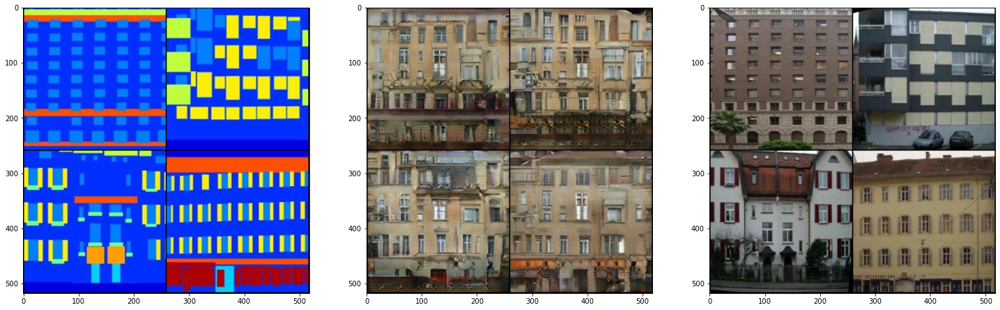

In [7]:
img_list1 = []
img_list2 = []
img_list3 = []

for epoch in range(epochs):
    D_losses = []
    G_losses = []
    train_bar = tqdm(train_loader, position=0, leave=True)
    running_results = {'batch_sizes': 0, 'd_loss': 0,
                       'g_loss': 0, 'd_score': 0, 'g_score': 0}
    for _data in train_bar:
        data, target = _data['from'], _data['to']
        data = Variable(data.to(device))
        target = Variable(target.to(device))
        batch_size = data.shape[0]
        running_results['batch_sizes'] += batch_size

        # real
        real_out = netD(data, target).squeeze()
        real_ = Variable(torch.ones(real_out.size()).to(device))
        d_real_loss = BCE_loss(real_out, real_)

        # fake
        gen_image = netG(data)
        fake_out = netD(data, gen_image).squeeze()
        fake_ = Variable(torch.zeros(fake_out.size()).to(device))
        d_fake_loss = BCE_loss(fake_out, fake_)


        d_loss = (d_real_loss + d_fake_loss) * 0.5
        netD.zero_grad()
        d_loss.backward()
        D_optimizer.step()


        gen_image = netG(data)
        fake_out = netD(data, gen_image).squeeze()
        g_fake_loss = BCE_loss(fake_out, real_)

        # L1 loss
        l1_loss = lamb * L1_loss(gen_image, target)

        g_loss = g_fake_loss + l1_loss
        netG.zero_grad()
        g_loss.backward()
        G_optimizer.step()
        D_losses.append(d_loss.data.item())
        G_losses.append(g_loss.data.item())
        
        running_results['g_loss'] += g_loss.item() * batch_size
        running_results['d_loss'] += d_loss.item() * batch_size

        train_bar.set_description(desc='[%d/%d] Loss_D: %.4f Loss_G: %.4f' % (
            epoch, 100, running_results['d_loss'] /
            running_results['batch_sizes'],
            running_results['g_loss'] / running_results['batch_sizes'],
            ))

#     netG.eval()
    
    with torch.no_grad():
        val_bar = tqdm(test_loader, position=0, leave=True)
        from_images = []
        pred_images = []
        to_images = []
        for data in val_bar:
            val_from, val_to = data['from'], data['to']
            val_from, val_to = val_from.to(device), val_to.to(device)
            pred = netG(val_from)
            
            from_images += val_from
            pred_images += pred
            to_images += val_to

        img_list1.append(vutils.make_grid(from_images[:4],nrow=2, padding=2, normalize=True))
        img_list2.append(vutils.make_grid(pred_images[:4],nrow=2, padding=2, normalize=True))
        img_list3.append(vutils.make_grid(to_images[:4],nrow=2, padding=2, normalize=True))
        clear_output(wait=True)
        plt.figure(figsize=(25, 25))
        plt.subplot(1, 3, 1)
        plt.imshow(np.transpose(vutils.make_grid(from_images[:4],nrow=2, padding=2, normalize=True).cpu(),(1,2,0)), animated=True)
        plt.subplot(1, 3, 2)
        plt.imshow(np.transpose(vutils.make_grid(pred_images[:4],nrow=2, padding=2, normalize=True).cpu(),(1,2,0)), animated=True)
        plt.subplot(1, 3, 3)
        plt.imshow(np.transpose(vutils.make_grid(to_images[:4],nrow=2, padding=2, normalize=True).cpu(),(1,2,0)), animated=True)
        plt.pause(0.05)
    torch.cuda.empty_cache()        
torch.save(netG.state_dict(), 'netG.pth')
torch.save(netD.state_dict(), 'netD.pth')


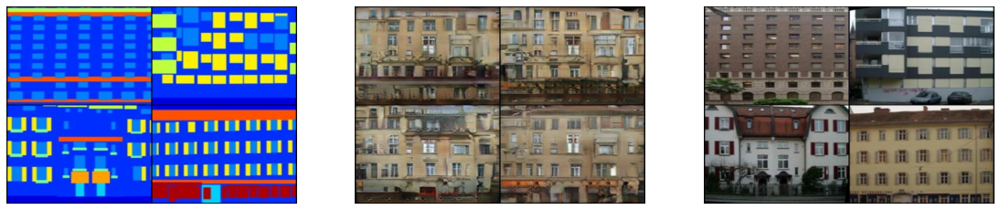

In [8]:
def display_transform():
    return transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(400),
        transforms.CenterCrop(400),
        transforms.ToTensor()
])
fig, (ax1,ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(15, 3))
ims = [np.transpose(display_transform()(i).cpu(),(1,2,0)) for i in img_list1]
ims2 = [np.transpose(display_transform()(i).cpu(),(1,2,0)) for i in img_list2]
ims3 = [np.transpose(display_transform()(i).cpu(),(1,2,0)) for i in img_list3]
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
def update(frame):
    ax1.clear()
    ax2.clear()
    ax3.clear()
    ax1.axis("off")
    ax2.axis('off')
    ax3.axis('off')
    ax1.imshow(ims[frame], aspect='auto')
    ax2.imshow(ims2[frame], aspect='auto')
    ax3.imshow(ims3[frame], aspect='auto')
    
ani = animation.FuncAnimation(fig, update, frames=len(ims), interval=200)
HTML(ani.to_jshtml())